In [1]:
import re
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

from pydriller import Repository
from wordcloud import WordCloud, STOPWORDS
from collections import Counter
from urllib.parse import urlparse


In [2]:
data = pd.read_csv("data.csv")
data.head(5)

,id,source_identifier,published_date,last_modified_date,status,description,references,configurations,weaknesses,v20_base_severity,...,v30_base_severity,v30_base_score,v30_vector_string,v30_exploitability_score,v30_impact_score,v31_base_severity,v31_base_score,v31_vector_string,v31_exploitability_score,v31_impact_score
0,CVE-1999-0095,cve@mitre.org,1988-10-01,2019-06-11,Modified,"The debug command in Sendmail is enabled, allo...",['http://seclists.org/fulldisclosure/2019/Jun/...,['cpe:2.3:a:eric_allman:sendmail:5.58:*:*:*:*:...,['NVD-CWE-Other'],HIGH,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CVE-1999-0082,cve@mitre.org,1988-11-11,2008-09-09,Analyzed,CWD ~root command in ftpd allows root access.,['http://www.alw.nih.gov/Security/Docs/admin-g...,"['cpe:2.3:a:ftp:ftp:*:*:*:*:*:*:*:*', 'cpe:2.3...",['NVD-CWE-Other'],HIGH,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,CVE-1999-1471,cve@mitre.org,1989-01-01,2008-09-05,Analyzed,Buffer overflow in passwd in BSD based operati...,['http://www.cert.org/advisories/CA-1989-01.ht...,"['cpe:2.3:o:bsd:bsd:4.2:*:*:*:*:*:*:*', 'cpe:2...",['NVD-CWE-Other'],HIGH,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,CVE-1999-1122,cve@mitre.org,1989-07-26,2018-05-03,Modified,Vulnerability in restore in SunOS 4.0.3 and ea...,['http://www.cert.org/advisories/CA-1989-02.ht...,"['cpe:2.3:o:sun:sunos:*:*:*:*:*:*:*:*', 'cpe:2...",['NVD-CWE-Other'],MEDIUM,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,CVE-1999-1467,cve@mitre.org,1989-10-26,2017-12-19,Modified,Vulnerability in rcp on SunOS 4.0.x allows rem...,['http://www.cert.org/advisories/CA-1989-07.ht...,"['cpe:2.3:o:sun:sunos:4.0:*:*:*:*:*:*:*', 'cpe...",['NVD-CWE-Other'],HIGH,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
data.describe()

,v20_base_score,v20_exploitability_score,v20_impact_score,v30_base_score,v30_exploitability_score,v30_impact_score,v31_base_score,v31_exploitability_score,v31_impact_score
count,182259.000000,182259.000000,182259.000000,51508.000000,51508.000000,51508.000000,106675.000000,106675.000000,106675.000000
mean,5.890994,8.074620,5.459026,7.197701,2.665365,4.379067,7.154218,2.677357,4.335681
std,1.977037,2.156058,2.581386,1.662456,0.929276,1.525647,1.696690,0.964248,1.532072
min,0.000000,1.200000,0.000000,1.800000,0.100000,1.400000,1.800000,0.100000,1.400000
25%,4.300000,8.000000,2.900000,6.100000,1.800000,3.600000,5.500000,1.800000,3.600000
50%,5.400000,8.600000,6.400000,7.500000,2.800000,4.000000,7.500000,2.800000,3.600000
75%,7.500000,10.000000,6.400000,8.600000,3.900000,5.900000,8.800000,3.900000,5.900000
max,10.000000,10.000000,10.000000,10.000000,3.900000,6.000000,10.000000,3.900000,6.000000


In [4]:
# % of missing data in each column
data.isna().sum()/len(data)*100

id                           0.000000
source_identifier            0.000000
published_date               0.000000
last_modified_date           0.000000
status                       0.000000
description                  0.000000
references                   0.000000
configurations               0.000000
weaknesses                   0.000000
v20_base_severity           22.871289
v20_base_score              22.871289
v20_vector_string           22.871289
v20_exploitability_score    22.871289
v20_impact_score            22.871289
v30_base_severity           78.202746
v30_base_score              78.202746
v30_vector_string           78.202746
v30_exploitability_score    78.202746
v30_impact_score            78.202746
v31_base_severity           54.857070
v31_base_score              54.857070
v31_vector_string           54.857070
v31_exploitability_score    54.857070
v31_impact_score            54.857070
dtype: float64

In [5]:
# we use v2.0 score because % of lacking data
# Convert datetime
data["published_date"] = pd.to_datetime(data["published_date"])
data["last_modified_date"] = pd.to_datetime(data["last_modified_date"])

In [6]:
#create year column
year_list=[]
for i in range(0,len(data["id"])):
    a=data["published_date"][i].year
    year_list.append(a)

data.insert(loc=2, column='year', value=year_list)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 236305 entries, 0 to 236304
Data columns (total 25 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   id                        236305 non-null  object        
 1   source_identifier         236305 non-null  object        
 2   year                      236305 non-null  int64         
 3   published_date            236305 non-null  datetime64[ns]
 4   last_modified_date        236305 non-null  datetime64[ns]
 5   status                    236305 non-null  object        
 6   description               236305 non-null  object        
 7   references                236305 non-null  object        
 8   configurations            236305 non-null  object        
 9   weaknesses                236305 non-null  object        
 10  v20_base_severity         182259 non-null  object        
 11  v20_base_score            182259 non-null  float64       
 12  v2

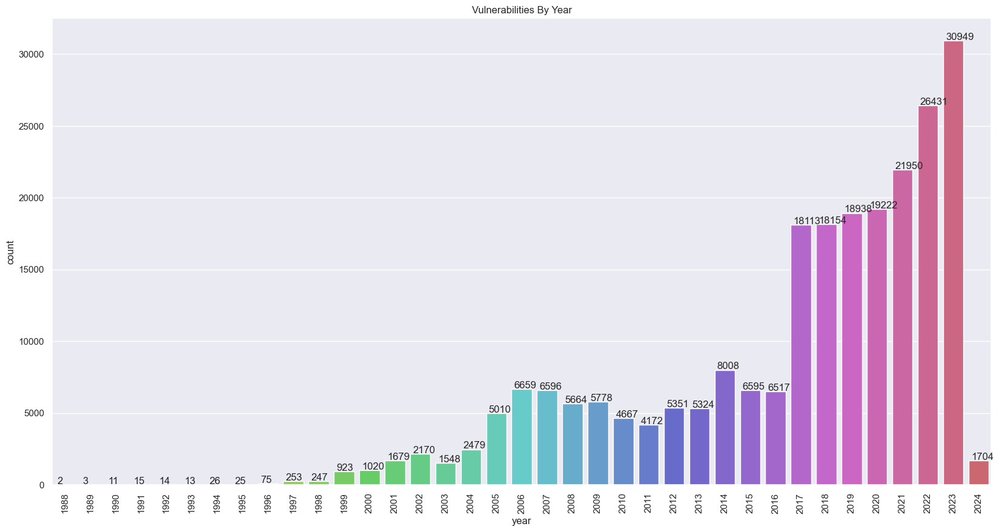

In [7]:
#the number of vulnerabilities reported by year.
plt.rcParams["figure.figsize"] = (20,10)
sns.set_theme(style="darkgrid")

ax = sns.countplot(x="year", data=data,palette="hls")
ax.set_title("Vulnerabilities By Year")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))
plt.xticks(rotation=90)
plt.show()

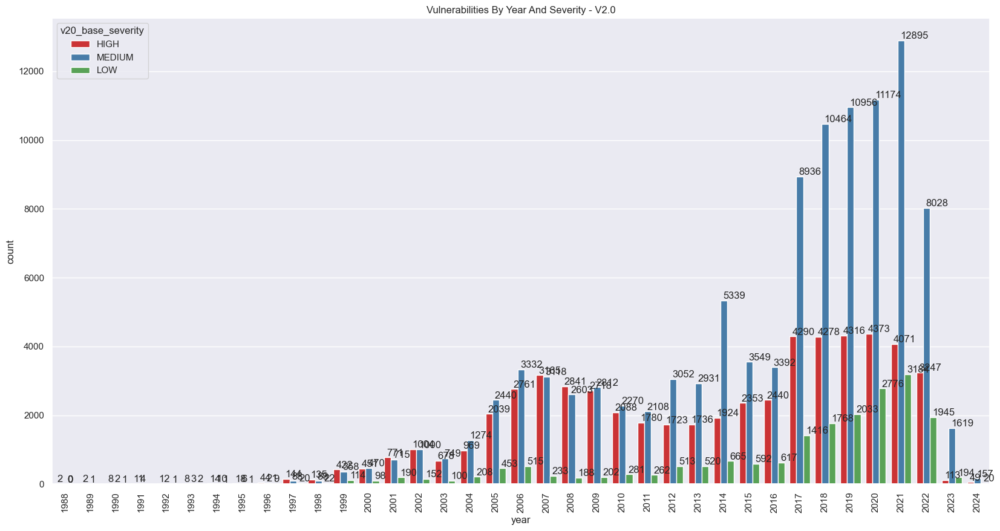

In [8]:
plt.rcParams["figure.figsize"] = (20,10)
sns.set_theme(style="darkgrid")

ax = sns.countplot(x="year", data=data,palette="Set1",hue="v20_base_severity")
ax.set_title("Vulnerabilities By Year And Severity - V2.0")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))
plt.xticks(rotation=90)
plt.show()

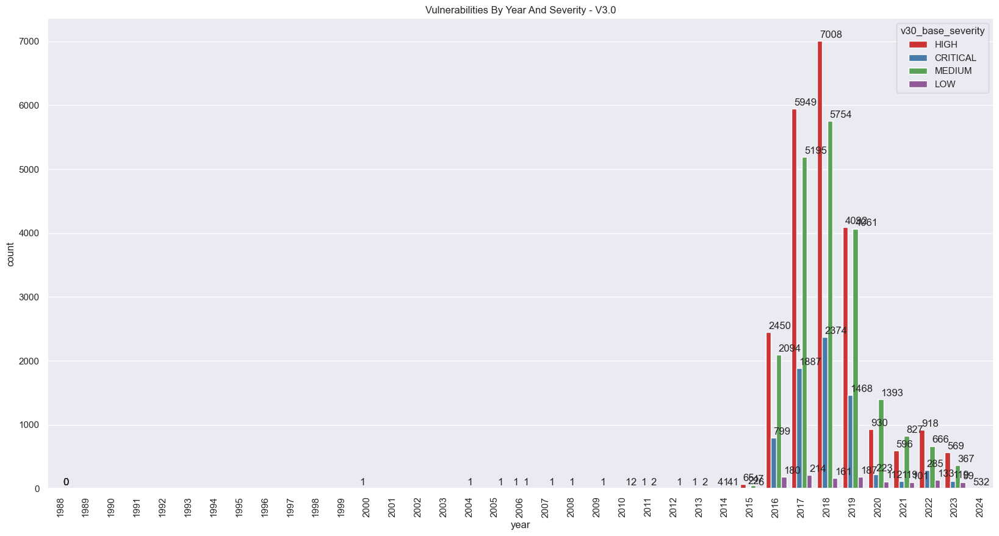

In [9]:
plt.rcParams["figure.figsize"] = (20,10)
sns.set_theme(style="darkgrid")

ax = sns.countplot(x="year", data=data,palette="Set1",hue="v30_base_severity")
ax.set_title("Vulnerabilities By Year And Severity - V3.0")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))
plt.xticks(rotation=90)
plt.show()

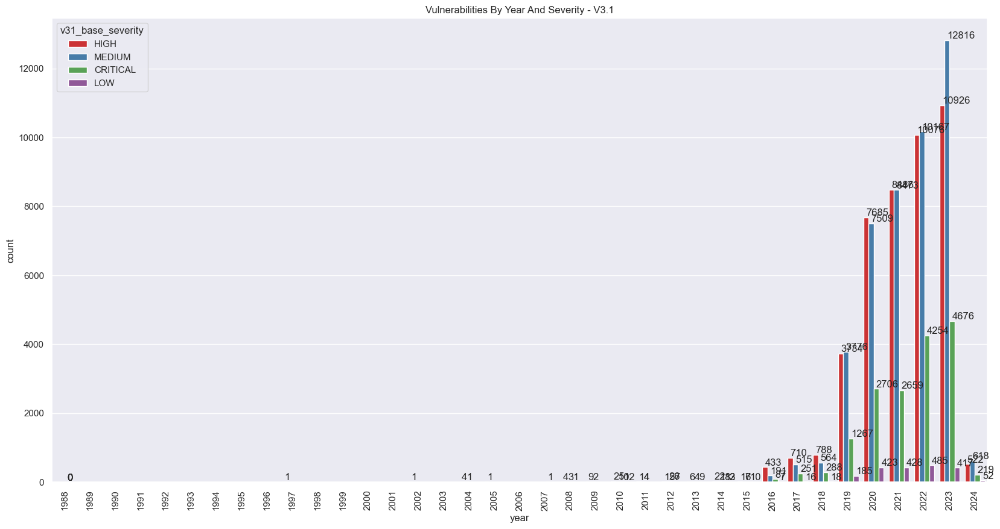

In [10]:
plt.rcParams["figure.figsize"] = (20,10)
sns.set_theme(style="darkgrid")

ax = sns.countplot(x="year", data=data,palette="Set1",hue="v31_base_severity")
ax.set_title("Vulnerabilities By Year And Severity - V3.1")
for p in ax.patches:
        ax.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))
plt.xticks(rotation=90)
plt.show()

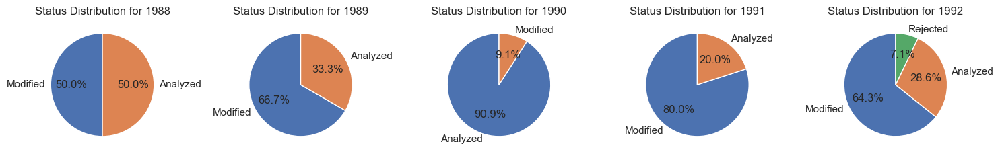

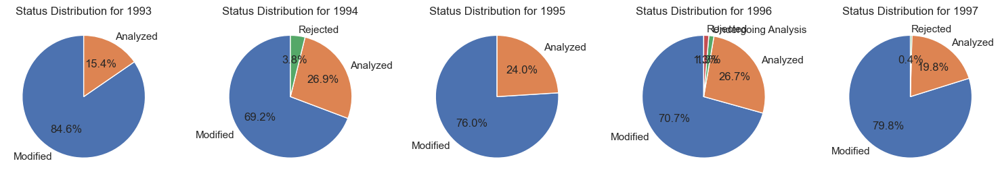

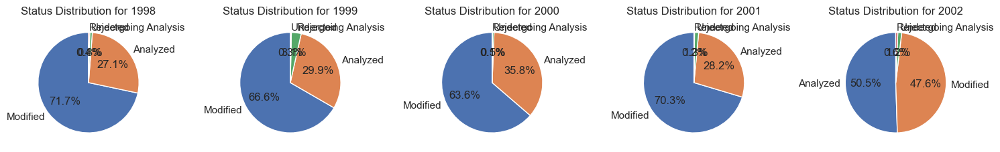

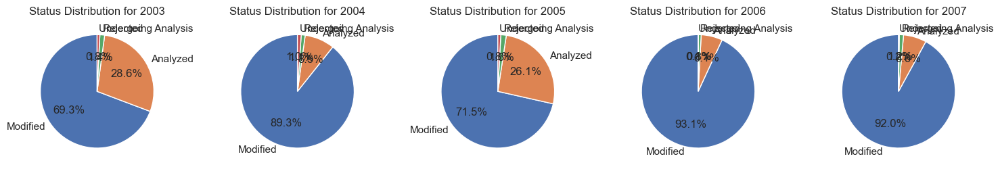

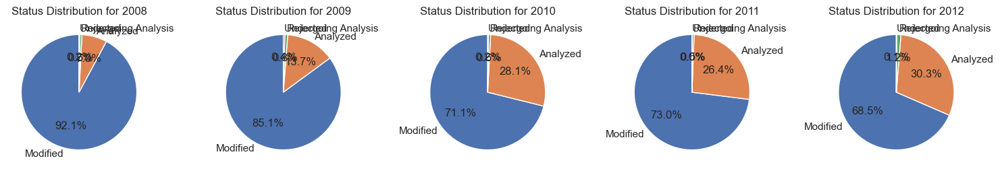

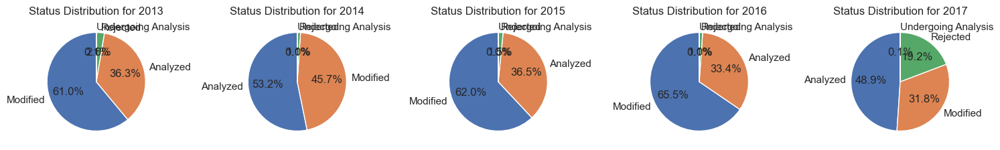

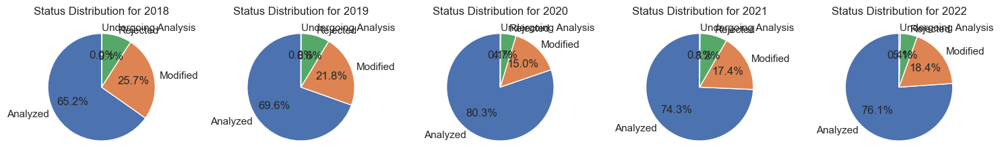

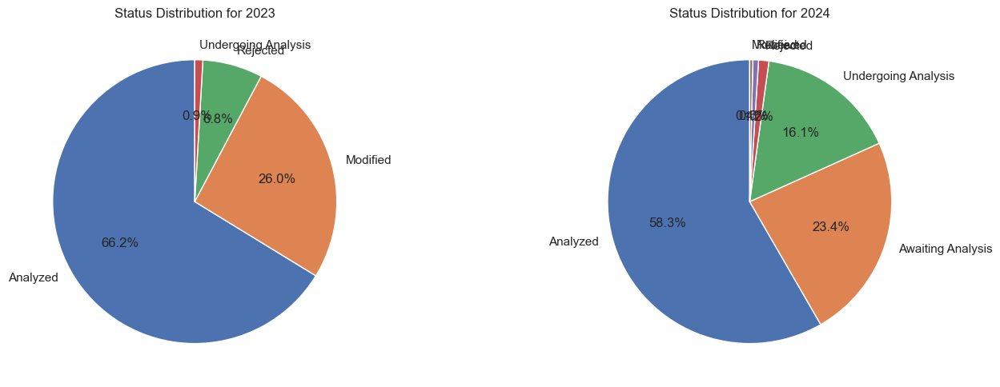

In [11]:
#status every year
unique_years = data['year'].unique()
num_years = len(unique_years)

subplots_per_figure = 5
num_figures = (num_years - 1) // subplots_per_figure + 1

for fig_num in range(num_figures):

    start_year = fig_num * subplots_per_figure
    end_year = min((fig_num + 1) * subplots_per_figure, num_years)

    # Create a figure with subplots
    fig, axes = plt.subplots(nrows=1, ncols=end_year - start_year, figsize=(15, 5))

    for i, year in enumerate(unique_years[start_year:end_year]):
        subset_df = data[data['year'] == year]
        status_counts = subset_df['status'].value_counts()

        # Plot the pie chart for each year
        axes[i].pie(status_counts, labels=status_counts.index, autopct='%1.1f%%', startangle=90)
        axes[i].set_title(f'Status Distribution for {year}')

    plt.tight_layout()
    plt.show()

In [12]:
data["weaknesses"].unique()

array(["['NVD-CWE-Other']", '[]', "['NVD-CWE-noinfo']", ...,
       "['CWE-627']", "['CWE-549']", "['CWE-158']"], dtype=object)

In [13]:
data["weaknesses"] = data["weaknesses"].replace('[]', np.nan)
data["weaknesses"].isna().sum()/len(data)*100

6.54577770254544

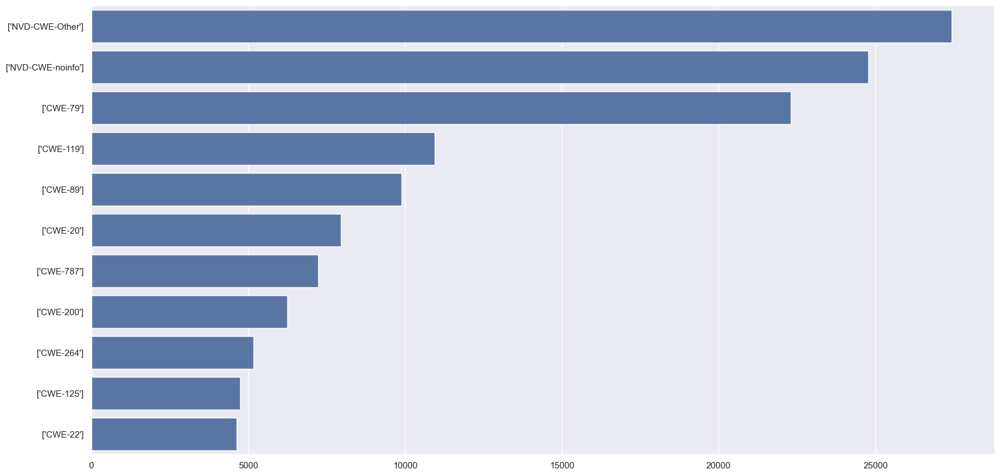

In [14]:
# Finding Prominent CWE
cwe_counter = dict(sorted(dict(Counter(data["weaknesses"])).items(), key=lambda x: x[-1], reverse=True))

sns.barplot(x=list(cwe_counter.values())[:12], y=list(cwe_counter.keys())[:12])
plt.show()

In [15]:
fig = px.histogram(
    data,
    x="v20_base_score",
    histfunc='avg',
    y="year",
    orientation='h',
    height=700,
    width=1000,
    text_auto='.2s',
    title="Average CVSS-V2.0 Score by Year",
    color="year",  # Add color based on the year for better differentiation
    color_discrete_sequence=px.colors.qualitative.Set1,  # Use a qualitative color palette
    labels={"v20_base_score": "Average CVSS-V2.0 Score", "year": "Year"}
)

# Update the layout for better visibility
fig.update_layout(
    showlegend=False,  # Hide legend for better clarity
    xaxis_title="Average CVSS-V2.0 Score",
    yaxis_title="Year",
    font=dict(family="Arial", size=12, color="RebeccaPurple"),  # Adjust font style
)

# Update the traces for better visibility
fig.update_traces(
    marker_line_color='rgb(8, 48, 107)',
    marker_line_width=1.5,
    opacity=0.8,
)

fig.show()

In [16]:
df = data[data['year']==1988]
df['v20_base_score']

0    10.0
1    10.0
Name: v20_base_score, dtype: float64

In [17]:
fig = px.histogram(
    data,
    x="v30_base_score",
    histfunc='avg',
    y="year",
    orientation='h',
    height=700,
    width=1000,
    text_auto='.2s',
    title="Average CVSS-V3.0 Score by Year",
    color="year",  # Add color based on the year for better differentiation
    color_discrete_sequence=px.colors.qualitative.Set1,  # Use a qualitative color palette
    labels={"v30_base_score": "Average CVSS-V3.0 Score", "year": "Year"}
)

# Update the layout for better visibility
fig.update_layout(
    showlegend=False,  # Hide legend for better clarity
    xaxis_title="Average CVSS-V3.0 Score",
    yaxis_title="Year",
    font=dict(family="Arial", size=12, color="RebeccaPurple"),  # Adjust font style
)

# Update the traces for better visibility
fig.update_traces(
    marker_line_color='rgb(8, 48, 107)',
    marker_line_width=1.5,
    opacity=0.8,
)

fig.show()

In [18]:
fig = px.histogram(
    data,
    x="v31_base_score",
    histfunc='avg',
    y="year",
    orientation='h',
    height=700,
    width=1000,
    text_auto='.2s',
    title="Average CVSS-V3.1 Score by Year",
    color="year",  # Add color based on the year for better differentiation
    color_discrete_sequence=px.colors.qualitative.Set1,  # Use a qualitative color palette
    labels={"v20_base_score": "Average CVSS-V3.1 Score", "year": "Year"}
)

# Update the layout for better visibility
fig.update_layout(
    showlegend=False,  # Hide legend for better clarity
    xaxis_title="Average CVSS-V3.1 Score",
    yaxis_title="Year",
    font=dict(family="Arial", size=12, color="RebeccaPurple"),  # Adjust font style
)

# Update the traces for better visibility
fig.update_traces(
    marker_line_color='rgb(8, 48, 107)',
    marker_line_width=1.5,
    opacity=0.8,
)

fig.show()

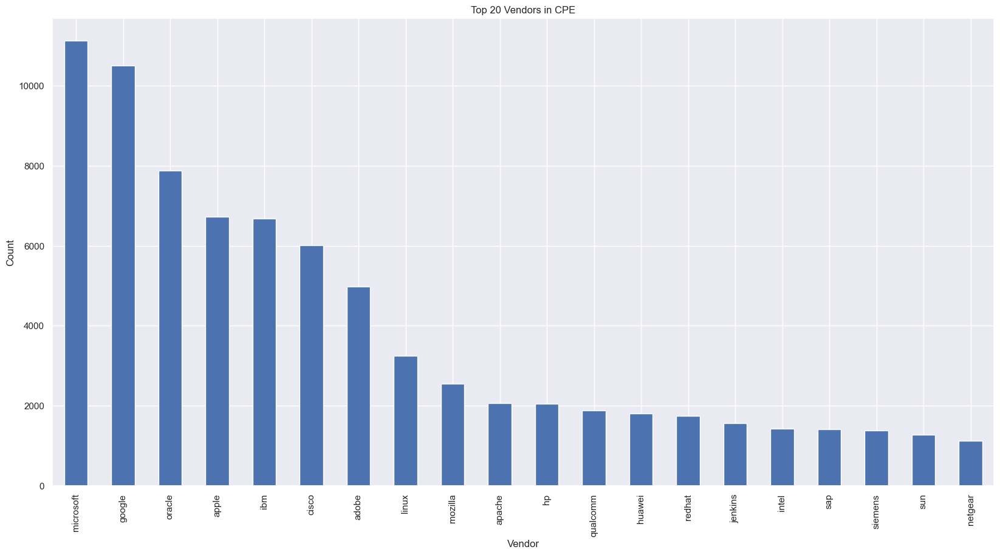

In [19]:
df_exploded = data.explode('configurations')

# Extract vendor information from configurations with error handling
def extract_vendor(config):
    try:
        return config.split(':')[3]
    except IndexError:
        return None

df_exploded['vendor'] = df_exploded['configurations'].apply(extract_vendor)

# Get the top 20 vendors
top_20_vendors = df_exploded['vendor'].value_counts().nlargest(20)

top_20_vendors.plot(kind='bar')
plt.xlabel('Vendor')
plt.ylabel('Count')
plt.title('Top 20 Vendors in CPE')
plt.show()

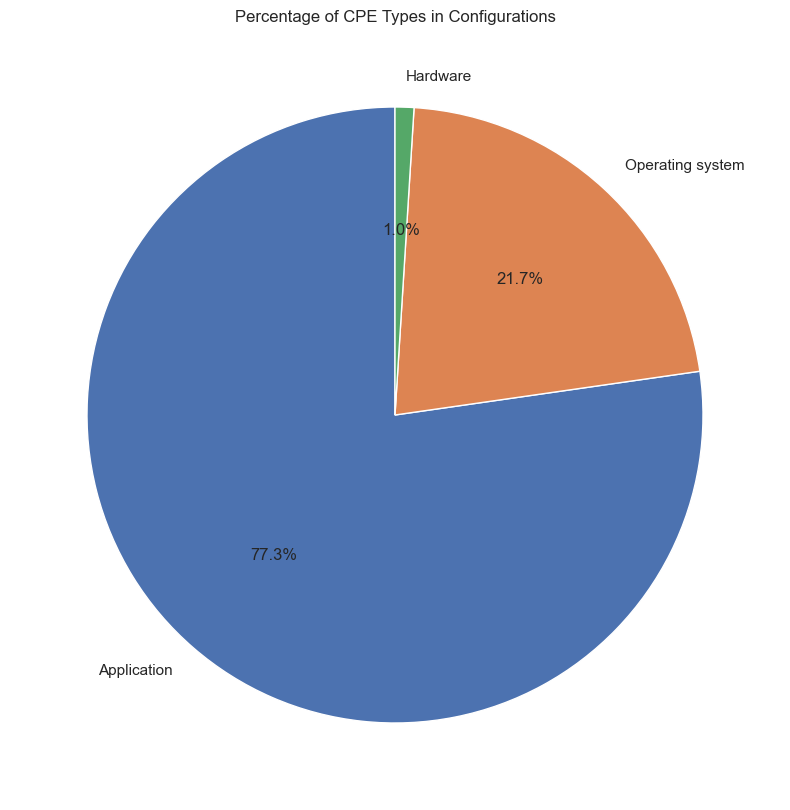

In [20]:
# type of cpe:
# a: Application
# h: Hardware
# o: Operating system

def extract_cpe_type(config):
    try:
        cpe_type = config.split(':')[2]
        type_mapping = {'a': 'Application', 'h': 'Hardware', 'o': 'Operating system'}
        return type_mapping.get(cpe_type, cpe_type)
    except IndexError:
        return None

df_exploded['cpe_type'] = df_exploded['configurations'].apply(extract_cpe_type)
cpe_type_counts = df_exploded['cpe_type'].value_counts()

# Plot the pie chart
plt.pie(cpe_type_counts, labels=cpe_type_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Percentage of CPE Types in Configurations')
plt.show()

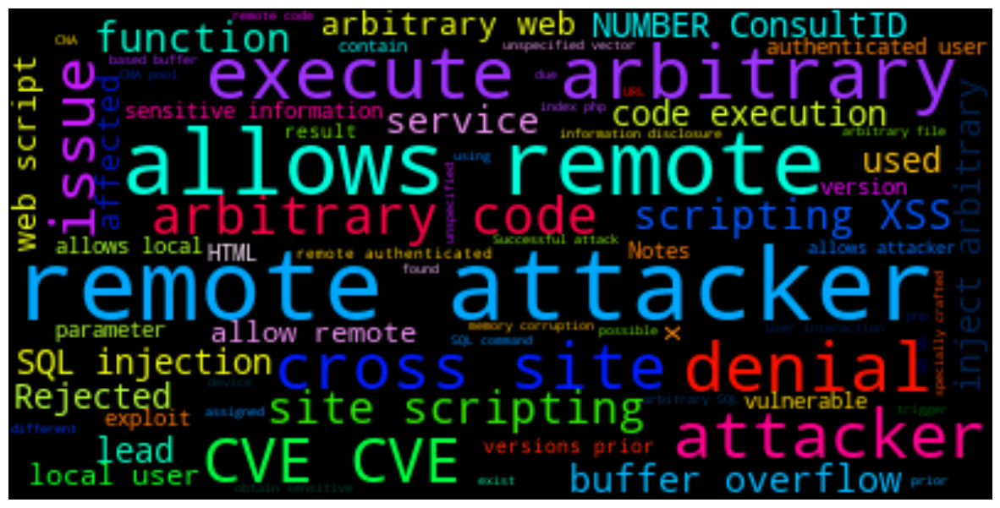

In [21]:
#the most used words in the "description" column of the dataset.
text = " ".join(desc for desc in data["description"])
stopwords = set(STOPWORDS)
stopwords.update(["will", "announcing", "via", "none", "vulnerability","cause","earlier","use", "reason","note","candidate","allows remote","discovered"])

wordcloud = WordCloud(
    background_color='black',
    colormap="gist_ncar",
    contour_width=1,
    stopwords=stopwords,
    contour_color="black"
).generate(text)

plt.rcParams["figure.figsize"] = (15, 15)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [31]:
github_links = data['references'].apply(lambda x: re.findall(r'https?://github\.com/[A-Za-z0-9-]+/[A-Za-z0-9-.]+/?', x))

# Flatten the list of GitHub links
flat_github_links = [link for sublist in github_links for link in sublist]

# Display the extracted GitHub links
print("GitHub Links: ",len(flat_github_links))

GitHub Links:  52328


In [34]:
github_commit_links = data['references'].apply(lambda x: re.findall(r'https?://github\.com/[A-Za-z0-9-]+/[A-Za-z0-9-.]+/commit/[0-9a-f]{40}', x))
flat_github_commit_links = [link for sublist in github_commit_links for link in sublist]

print("GitHub commit Links: ",len(flat_github_commit_links))

GitHub commit Links:  13229


In [48]:
from pydriller.git import Git
import csv

commit_link = flat_github_commit_links[0]

commit_hash = commit_link.split("/")[-1]
repo_link = commit_link.split("/commit/")[0]

repo = Repository(repo_link)
result =[]

for commit in repo.traverse_commits():
    if commit.hash == commit_hash:
        files = []
        try:
            for f in commit.modified_files:
                if f.new_path is not None:
                    files.append(f.new_path) 
        except Exception:
            print('Could not read files for commit ' + hash)
            continue
        
        record = {
            'hash': hash,
            'message': commit.msg,
            'author_name': commit.author.name,
            'author_email': commit.author.email,
            'author_date': commit.author_date,
            'author_tz': commit.author_timezone,
            'committer_name': commit.committer.name,
            'committer_email': commit.committer.email,
            'committer_date': commit.committer_date,
            'committer_tz': commit.committer_timezone,
            'in_main': commit.in_main_branch,
            'is_merge': commit.merge,
            'num_deletes': commit.deletions,
            'num_inserts': commit.insertions,
            'net_lines': commit.insertions - commit.deletions,
            'num_files': commit.files,
            'branches': ', '.join(commit.branches), # Comma separated list of branches the commit is found in
            'files': ', '.join(files), # Comma separated list of files the commit modifies
            'parents': ', '.join(commit.parents), # Comma separated list of parents
            # PyDriller Open Source Delta Maintainability Model (OS-DMM) stat. See https://pydriller.readthedocs.io/en/latest/deltamaintainability.html for metric definitions
            'dmm_unit_size': commit.dmm_unit_size,
            'dmm_unit_complexity': commit.dmm_unit_complexity,
            'dmm_unit_interfacing': commit.dmm_unit_interfacing,
        }
        result.append(record)
result

[{'hash': <function hash(obj, /)>,
  'message': 'Fix for password entry/dialog deletion race.',
  'author_name': 'KDE Dinosaur jones',
  'author_email': 'cvsuser@kde.org',
  'author_date': datetime.datetime(1999, 6, 24, 11, 38, 11, tzinfo=<git.objects.util.tzoffset object at 0x7fecd45af040>),
  'author_tz': 0,
  'committer_name': 'KDE Dinosaur jones',
  'committer_email': 'cvsuser@kde.org',
  'committer_date': datetime.datetime(1999, 6, 24, 11, 38, 11, tzinfo=<git.objects.util.tzoffset object at 0x7fec8d856d60>),
  'committer_tz': 0,
  'in_main': True,
  'is_merge': False,
  'num_deletes': 0,
  'num_inserts': 1,
  'net_lines': 1,
  'num_files': 1,
  'branches': 'master',
  'files': 'kscreensaver/saver.cpp',
  'parents': '97b820813960d87174deca43ed34c6cd5cd03d11',
  'dmm_unit_size': 0.0,
  'dmm_unit_complexity': 0.0,
  'dmm_unit_interfacing': 1.0}]

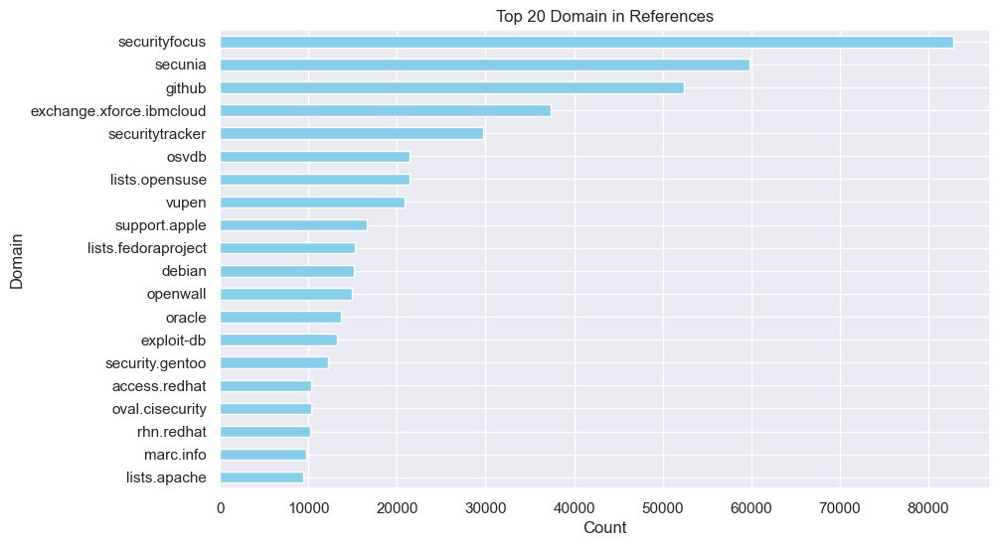

In [23]:
def extract_domain(url):
    parsed_url = urlparse(url)
    domain_name = parsed_url.netloc
    domain_name = domain_name.replace(".com", "").replace("www.", "").replace(".org", "")
    return domain_name

data['domain_from_references'] = data['references'].apply(lambda x: [extract_domain(url) for url in eval(x)])
all_domains = [domain for sublist in data['domain_from_references'].dropna() for domain in sublist]

domain_counts = pd.Series(all_domains).value_counts().nlargest(20)
domain_counts = domain_counts.iloc[::-1]

plt.figure(figsize=(10, 6))
domain_counts.plot(kind='barh', color='skyblue')
plt.title('Top 20 Domain in References')
plt.xlabel('Count')
plt.ylabel('Domain')
plt.show()